In [1]:
import pandas as pd
from pyspark.sql import SparkSession
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.recommendation import ALS

from sklearn.metrics import mean_squared_error

import pickle
from collections import defaultdict
import json

from tqdm import tqdm 

import pandas as pd, numpy as np, matplotlib.pyplot as plt

import sys 
sys.path.insert(1, "../")
from workloads.util import use_results, use_dataset, read_config, log_dataset

%load_ext autoreload
%autoreload 2

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [292]:
dataset_dir = use_dataset("ml-1m")

/data/wooders/ralf-vldb//datasets/ml-1m


In [294]:
ratings_path = f"{dataset_dir}/ratings.csv"
ratings_df = pd.read_csv(ratings_path)
ratings_df.columns = ['user_id', 'movie_id', 'rating', 'timestamp']

In [295]:
ratings_df

,user_id,movie_id,rating,timestamp
0,1,661,3,978302109
1,1,914,3,978301968
2,1,3408,4,978300275
3,1,2355,5,978824291
4,1,1197,3,978302268
...,...,...,...,...
1000203,6040,1091,1,956716541
1000204,6040,1094,5,956704887
1000205,6040,562,5,956704746
1000206,6040,1096,4,956715648


In [296]:
ratings_df = ratings_df.sort_values(by="timestamp")

<AxesSubplot:xlabel='timestamp'>

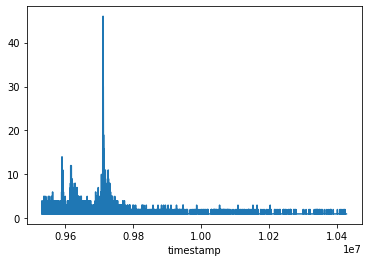

In [339]:
ratings_df.groupby(by="timestamp").user_id.nunique().plot()

In [297]:
ratings_df.timestamp = ratings_df.timestamp.apply(lambda ts: int((ts - start_ts)/100))
ratings_df

,user_id,movie_id,rating,timestamp
1000137,6040,858,4,9531243
1000152,6040,2384,4,9531243
999872,6040,593,5,9531243
1000006,6040,1961,4,9531243
1000191,6040,2019,5,9531243
...,...,...,...,...
825792,4958,2399,1,10428747
825437,4958,1407,5,10428748
825723,4958,3264,4,10428749
825730,4958,2634,3,10428749


In [340]:
def split_data(df):  
    start_ts = df['timestamp'].min()
    med_ts = df['timestamp'].quantile(.25)
    end_ts = df['timestamp'].max()
    train_df = df[df['timestamp'] <= med_ts]
    stream_df = df[df['timestamp'] > med_ts]
    seen_movies = set(train_df['movie_id'])
    print(len(seen_movies), len(set(stream_df['movie_id'])), len(stream_df))
    train_df.to_csv(f'{dataset_dir}/train.csv', header=True, index = False)
    stream_df.to_csv(f'{dataset_dir}/stream.csv', header=True, index = False)
    return start_ts, med_ts, end_ts

In [341]:
start_ts, med_ts, end_ts = split_data(ratings_df)
train_df = pd.read_csv(f'{dataset_dir}/train.csv')
test_df = pd.read_csv(f'{dataset_dir}/stream.csv')
test_df

3346 3676 750127


,user_id,movie_id,rating,timestamp
0,4269,2144,4,9617231
1,4269,3538,4,9617231
2,4268,1198,4,9617231
3,4269,539,2,9617231
4,4269,1747,5,9617231
...,...,...,...,...
750122,4958,2399,1,10428747
750123,4958,1407,5,10428748
750124,4958,3264,4,10428749
750125,4958,2634,3,10428749


In [300]:
n = ratings_df.user_id.max()+1
m = ratings_df.movie_id.max()+1
d = 50 
print(n, m, d)

6041 3953 50


In [301]:
def initialize_features(n, m, d):
    user_features = np.random.randn(n, d+1)
    movie_features = np.random.randn(m, d+1)
    user_features[:, -1] = 0
    movie_features[:, -1] = 0
    return user_features, movie_features

In [302]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error

In [303]:
alpha = 0.1

# ratings is an n by m sparse matrix
def update_user(user_id, ratings, d=50):

    user_data = ratings.getrow(user_id).tocoo() # lookup all rating data for this user
    movie_ids = user_data.col
    values = user_data.data
        #movie_ids and values are both k x 1 
    k = len(movie_ids)
    X = movie_features[movie_ids, :d] # k x d matrix 
    # The movie bias is the d+1 (last column) of the movie features
    movie_biases = movie_features[movie_ids, -1] # k x 1 matrix
    # Subtract off the movie biases
    Y = values - movie_biases

    # Use Sklearn to solve l2 regularized regression problem
    #from sklearn.lienar_model import Ridge, RidgeCV # we could use the CV version ...
    model = Ridge(alpha=alpha) #Maybe use RidgeCV() instead so we don't tune lambda
    model.fit(X, Y)

    user_features[user_id, :d] = model.coef_
    user_features[user_id, -1] = model.intercept_

    return user_features[user_id, :]

def update_movie(movie_id, ratings, d=50):

    movie_data = ratings.getcol(movie_id).tocoo() # lookup all rating data for this user
    user_ids = movie_data.row
    values = movie_data.data
        #movie_ids and values are both k x 1 
    k = len(user_ids)
    X = user_features[user_ids, :d] # k x d matrix 
    # The movie bias is the d+1 (last column) of the movie features
    user_biases = user_features[user_ids, -1] # k x 1 matrix
    # Subtract off the movie biases
    Y = values - user_biases

    # Use Sklearn to solve l2 regularized regression problem
    #from sklearn.lienar_model import Ridge, RidgeCV # we could use the CV version ...
    model = Ridge(alpha=alpha) #Maybe use RidgeCV() instead so we don't tune lambda
    model.fit(X, Y)

    movie_features[movie_id, :d] = model.coef_
    movie_features[movie_id, -1] = model.intercept_

    return movie_features[movie_id, :]

def loss(ratings): 
    #mf = movie_features[ratings.col, :d]
    #uf = user_features[ratings.row, :d]
    #y_true = ratings.data
    #y_pred = [predict_user_movie_rating(uf[i], mf[i]) for i in range(len(y_true))]
    y_pred = []
    y_true = []
    for item in ratings.items():
        y_pred.append(predict_user_movie_rating(user_features[item[0][0], :d], movie_features[item[0][1], :d]))
        y_true.append(item[1])
    #print(y_pred)
    #print(y_true)
    return mean_squared_error(y_true, y_pred)
    

def predict_user_movie_rating(user_feature, movie_feature):
    return user_feature[-1] + movie_feature[-1] + user_feature[:d] @ movie_feature[:d]

# Train Initial Model 

In [344]:
# Train model 
from scipy.sparse import coo_matrix
from scipy.sparse import dok_matrix

ratings = coo_matrix(
    (
        train_df.rating.to_numpy(), 
        (train_df.user_id.to_numpy(dtype=np.int32), train_df.movie_id.to_numpy(dtype=np.int32))),
    shape=(n, m)
)
# convert to dok matrix so can be updated 
ratings = dok_matrix(ratings)

In [345]:
user_features, movie_features = initialize_features(n, m, d)

In [346]:
loss(ratings)

66.33902013763593

In [347]:
# store past updates 
past_updates = {uid: ratings.getrow(uid).size for uid in uids}
pickle.dump(past_updates, open("past_updates.pkl", "wb"))

In [348]:
#uids = list(set(ratings.row.tolist()))
#mids = list(set(ratings.col.tolist()))
uids = list(set([k[0] for k in ratings.keys()]))
mids = list(set([k[1] for k in ratings.keys()]))

pickle.dump(ratings, open("ratings.pkl", "wb"))

# train 
for i in range(5): 
    print("update users...")
    for uid in tqdm(uids): 
        update_user(uid, ratings)
    print("update movies...")
    for mid in tqdm(mids): 
        update_movie(mid, ratings)
    print("loss", loss(ratings))
    pickle.dump(user_features, open("train_user_features.pkl", "wb"))
    pickle.dump(movie_features, open("train_movie_features.pkl", "wb"))
    

update users...


100%|████████████████████████████████████████████████████████| 1772/1772 [01:15<00:00, 23.34it/s]


update movies...


100%|████████████████████████████████████████████████████████| 3346/3346 [02:17<00:00, 24.37it/s]


loss 14.80797812579689
update users...


100%|████████████████████████████████████████████████████████| 1772/1772 [01:16<00:00, 23.25it/s]


update movies...


 17%|█████████▍                                               | 557/3346 [00:25<02:05, 22.17it/s]


KeyboardInterrupt: 

# Stream Additional Ratings 

In [354]:
test_df = pd.read_csv(f'{dataset_dir}/stream.csv')
start_ts = test_df.timestamp.min()
test_df.timestamp = test_df.timestamp.apply(lambda ts: int((ts - start_ts)/100))

<AxesSubplot:xlabel='timestamp'>

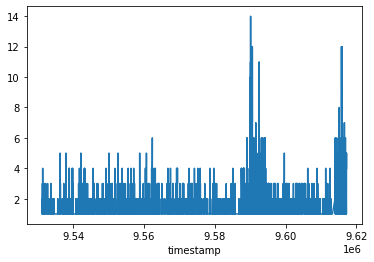

In [350]:
train_df.groupby(by="timestamp").user_id.nunique().plot()

<AxesSubplot:xlabel='timestamp'>

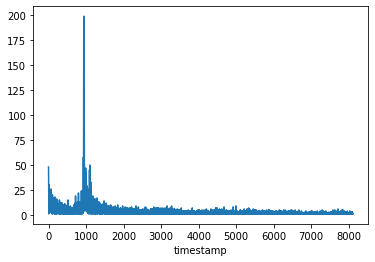

In [355]:
test_df.groupby(by="timestamp").user_id.nunique().plot()

In [356]:
test_df.user_id.value_counts()

4169    2314
1680    1850
1941    1595
1181    1521
889     1518
        ... 
4704       1
4821       1
5361       1
5426       1
6028       1
Name: user_id, Length: 4703, dtype: int64

In [357]:
test_df[test_df["user_id"] == 1941].timestamp.value_counts()

964     410
954     325
955     321
965     192
2434     81
1008     32
2397     26
2433     25
938      23
5403     22
3374     22
6561     21
5395     19
3384     12
5404     12
3039     11
3036      8
6492      7
3037      6
3385      5
5378      3
939       2
1378      2
5398      2
1259      2
5889      2
3607      1
5649      1
Name: timestamp, dtype: int64

In [358]:
data = {}

for ts, group in tqdm(test_df.groupby("timestamp")):
    data[ts] = group.to_dict("records")

100%|██████████████████████████████████████████████████████| 5956/5956 [00:03<00:00, 1954.97it/s]


In [359]:
class UserEventQueue: 
    
    """
    Event queue that selects group of user updates
    (note: we can have another implementation which triggers a bunch of updates together)
    """
    
    def __init__(self, num_keys, policy, past_updates): 
        self.policy = policy 
        self.num_keys = num_keys
        
        # metric tracking
        self.total_error = np.zeros((num_keys))
        self.past_updates = past_updates
        for key in self.past_updates.keys(): # unseen keys start with high total error 
            self.total_error[key] = 1000000 
        self.queue = defaultdict(list)
        self.staleness = defaultdict(lambda: 0)
        
    def push(self, uid, mid, rating): 
        
        # calcualte error 
        pred = predict_user_movie_rating(user_features[uid], movie_features[mid])
        error = abs(pred - rating) #error*error # square 
        
        # update per key 
        self.total_error[uid] += error
        self.queue[uid].append((uid, mid, rating))
        
    def arg_max(self, data_dict): 
        max_key = None
        max_val = None
        for key in self.queue.keys():
            
            # cannot select empty queue 
            if len(self.queue[key]) <= 0: 
                continue 
                
            value = data_dict[key]
            if max_key is not None and max_val is None: 
                print("max", max_val, max_val is None)
                print("huh", max_key, max_val, data_dict)
                print(value)
                print(self.queue)
            if max_key is None or max_val <= value: 
                assert key is not None, f"Invalid key {data_dict}"
                max_key = key
                max_val = value
        return max_key
        
        
    def choose_key(self): 
        if self.policy == "total_error":
            key = self.arg_max(self.total_error)
        elif self.policy == "max_pending":
            key = self.arg_max({key: len(self.queue[key]) for key in self.queue.keys()})
        elif self.policy == "min_past": 
            key = self.arg_max({key: 1/(self.past_updates.setdefault(key, 0)+1) for key in self.queue.keys()})
        elif self.policy == "round_robin": 
            key = self.arg_max(self.staleness)
        else: 
            raise ValueError("Invalid policy")
       
        assert key is not None or sum([len(v) for v in self.queue.values()]) == 0, f"Key is none, {self.queue}"
        return key 
    
    def pop(self): 
        key = self.choose_key()
        if key is None:
            print("no updates", self.queue)
            return None 
        events = self.queue[key]
        self.queue[key] = []

        # update metrics 
        for key in self.queue.keys():
            self.staleness[key] += 1
        self.staleness[key] = 0
        self.total_error[key] = 0
        self.past_updates[key] = self.past_updates.setdefault(key, 0) + 1
            
        return key  

In [360]:
def experiment(policy, updates_per_ts, results_dir="."): 

    ratings = pickle.load(open("ratings.pkl", "rb"))

    user_features = pickle.load(open("train_user_features.pkl", "rb"))
    movie_features = pickle.load(open("train_movie_features.pkl", "rb"))

    train_user_features = pickle.load(open("train_user_features.pkl", "rb"))
    train_movie_features = pickle.load(open("train_movie_features.pkl", "rb"))

    past_updates = pickle.load(open("past_updates.pkl", "rb"))

    y_pred = [] 
    y_true = []
    users = []
    movies = []
    update_times = defaultdict(list)

    queue = UserEventQueue(n, policy, past_updates) 
    for ts in tqdm(list(data.keys())): 

        # process events
        updated_users = set([])
        for event in data[ts]:

            uid = event["user_id"]
            mid = event["movie_id"]
            rating = event["rating"]

            ratings[uid, mid] = rating 
            queue.push(uid, mid, rating)
            #print("orig loss:", loss(ratings))

            y_pred.append(predict_user_movie_rating(user_features[uid], movie_features[mid]))
            y_true.append(rating)
            users.append(uid)
            movies.append(mid)
            
        for i in range(updates_per_ts): 
            uid = queue.pop()
            if uid is None: 
                print(f"{ts}: No updates in queue")
                break 
            user_features[uid] = update_user(uid, ratings, d)
            update_times[uid].append(ts)
            
         
    runtime = 1/updates_per_ts
    update_df = pd.DataFrame([
        [policy, runtime, k, i, update_times[k][i]]
        for k, v in update_times.items() for i in range(len(v))
    ], columns = ["policy", "runtime", "key", "i", "time"])
    results_df = pd.DataFrame({"y_true": y_true, "y_pred": y_pred, "user_id": users, "movie_id": movies})
    

    update_df.to_csv(f"{results_dir}/{policy}_{updates_per_ts}_updates.csv")
    results_df.to_csv(f"{results_dir}/{policy}_{updates_per_ts}_results.csv")
    

In [374]:
#experiment("min_past", 1)

In [362]:
results_dir = "."
policies = ["total_error", "max_pending", "min_past", "round_robin"]
updates_per_ts = [1, 2]

In [363]:
import concurrent.futures

results_dir = "."
policies = ["total_error", "max_pending", "min_past", "round_robin"]
#policies = ["min_past"]
updates_per_ts = [1, 2]

#experiments = [(p, u, ".") for p in policies for u in updates_per_ts]
futures = []
with concurrent.futures.ProcessPoolExecutor(20) as executor:
    for p in policies: 
        for u in updates_per_ts: 
            futures.append(executor.submit(experiment, p, u, results_dir))
     
    print("waiting")
    res = concurrent.futures.wait(futures)
    print("done", res)
    executor.shutdown()

  0%|                                                                   | 0/5956 [00:00<?, ?it/s]

waiting


 77%|███████████████████████████████████████████▎            | 4600/5956 [38:33<12:11,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5785: No updates in queue


 78%|███████████████████████████████████████████▍            | 4619/5956 [38:33<11:39,  1.91it/s]

no updates

 79%|████████████████████████████████████████████▌           | 4735/5956 [38:33<09:41,  2.10it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


5786: No updates in queue


 77%|███████████████████████████████████████████▎            | 4601/5956 [38:33<11:28,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5788: No updates in queue


 80%|████████████████████████████████████████████▌           | 4743/5956 [38:37<10:00,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5804: No updates in queue


 78%|███████████████████████████████████████████▌            | 4627/5956 [38:38<12:20,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5806: No updates in queue


 77%|███████████████████████████████████████████             | 4586/5956 [38:39<09:26,  2.42it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5812: No updates in queue


 80%|████████████████████████████████████████████▋           | 4747/5956 [38:39<10:04,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5815: No updates in queue


 80%|████████████████████████████████████████████▋           | 4751/5956 [38:42<10:25,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5822: No updates in queue


 78%|███████████████████████████████████████████▌            | 4637/5956 [38:43<10:43,  2.05it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5825: No updates in queue


 77%|███████████████████████████████████████████▏            | 4596/5956 [38:43<08:58,  2.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5826: No updates in queue


 80%|████████████████████████████████████████████▋           | 4754/5956 [38:43<10:54,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5828: No updates in queue


 78%|███████████████████████████████████████████▌            | 4639/5956 [38:44<11:19,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5832: No updates in queue


 78%|███████████████████████████████████████████▍            | 4621/5956 [38:44<11:47,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5833: No updates in queue


 78%|███████████████████████████████████████████▋            | 4640/5956 [38:44<11:40,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5834: No updates in queue


 78%|███████████████████████████████████████████▍            | 4622/5956 [38:45<12:04,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5835: No updates in queue


 80%|████████████████████████████████████████████▋           | 4757/5956 [38:45<11:14,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5836: No updates in queue


 77%|███████████████████████████████████████████▎            | 4610/5956 [38:48<11:00,  2.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████████████▋            | 4647/5956 [38:48<11:10,  1.95it/s]

5846: No updates in queue


 78%|███████████████████████████████████████████▌            | 4629/5956 [38:48<11:24,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5849: No updates in queue


 78%|███████████████████████████████████████████▋            | 4648/5956 [38:49<10:33,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5850: No updates in queue


 78%|███████████████████████████████████████████▌            | 4630/5956 [38:49<11:49,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5851: No updates in queue


 80%|████████████████████████████████████████████▊           | 4765/5956 [38:49<10:52,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5856: No updates in queue


 78%|███████████████████████████████████████████▌            | 4631/5956 [38:49<11:19,  1.95it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5858: No updates in queue


 80%|████████████████████████████████████████████▊           | 4767/5956 [38:50<10:26,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5860: No updates in queue


 80%|████████████████████████████████████████████▊           | 4770/5956 [38:51<09:23,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5865: No updates in queue


 79%|████████████████████████████████████████████▏           | 4702/5956 [39:25<11:10,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5953: No updates in queue


 81%|█████████████████████████████████████████████▍          | 4835/5956 [39:25<10:05,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5954: No updates in queue


 79%|████████████████████████████████████████████▎           | 4710/5956 [39:29<11:06,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5964: No updates in queue


 81%|█████████████████████████████████████████████▌          | 4843/5956 [39:30<09:57,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5967: No updates in queue


 79%|████████████████████████████████████████████▎           | 4711/5956 [39:30<10:34,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5968: No updates in queue


 81%|█████████████████████████████████████████████▌          | 4844/5956 [39:30<10:24,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5969: No updates in queue


 79%|████████████████████████████████████████████▎           | 4712/5956 [39:30<10:35,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


5970: No updates in queue


 80%|████████████████████████████████████████████▋           | 4753/5956 [39:44<10:43,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6008: No updates in queue


 80%|████████████████████████████████████████████▌           | 4740/5956 [39:45<11:44,  1.73it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6009: No updates in queue


 82%|█████████████████████████████████████████████▊          | 4875/5956 [39:46<09:47,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6015: No updates in queue


 80%|████████████████████████████████████████████▌           | 4743/5956 [39:46<11:05,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6016: No updates in queue


 82%|█████████████████████████████████████████████▊          | 4876/5956 [39:47<09:51,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6017: No updates in queue


 80%|████████████████████████████████████████████▌           | 4746/5956 [39:48<10:25,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6020: No updates in queue


 80%|████████████████████████████████████████████▋           | 4747/5956 [39:48<10:51,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6025: No updates in queue


 82%|█████████████████████████████████████████████▉          | 4888/5956 [39:53<09:43,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6038: No updates in queue


 80%|████████████████████████████████████████████▋           | 4748/5956 [39:55<09:48,  2.05it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6044: No updates in queue


 80%|████████████████████████████████████████████▋           | 4750/5956 [39:56<08:43,  2.30it/s]

no updates 

 82%|██████████████████████████████████████████████          | 4893/5956 [39:56<09:33,  1.85it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


6048: No updates in queue


 80%|████████████████████████████████████████████▊           | 4760/5956 [39:56<10:57,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6050: No updates in queue


 80%|████████████████████████████████████████████▋           | 4752/5956 [39:56<06:51,  2.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6051: No updates in queue


 80%|████████████████████████████████████████████▊           | 4761/5956 [39:56<11:14,  1.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6052: No updates in queue


 80%|████████████████████████████████████████████▋           | 4754/5956 [39:57<05:46,  3.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6053: No updates in queue


 82%|██████████████████████████████████████████████          | 4895/5956 [39:57<09:45,  1.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6056: No updates in queue


 80%|████████████████████████████████████████████▊           | 4768/5956 [40:00<11:07,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6064: No updates in queue


 80%|████████████████████████████████████████████▊           | 4769/5956 [40:01<10:30,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6065: No updates in queue


 83%|██████████████████████████████████████████████▍         | 4941/5956 [40:22<09:49,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6117: No updates in queue


 81%|█████████████████████████████████████████████▎          | 4820/5956 [40:22<10:45,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6120: No updates in queue


 81%|█████████████████████████████████████████████▏          | 4811/5956 [40:23<10:38,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6122: No updates in queue


 81%|█████████████████████████████████████████████▎          | 4822/5956 [40:23<10:54,  1.73it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6123: No updates in queue


 81%|█████████████████████████████████████████████▏          | 4812/5956 [40:24<10:52,  1.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6124: No updates in queue


 81%|█████████████████████████████████████████████▎          | 4823/5956 [40:24<10:58,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6126: No updates in queue


 81%|█████████████████████████████████████████████▎          | 4824/5956 [40:24<11:07,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6130: No updates in queue


 84%|███████████████████████████████████████████████         | 5005/5956 [40:55<08:10,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6217: No updates in queue


 82%|█████████████████████████████████████████████▊          | 4869/5956 [40:55<07:26,  2.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6219: No updates in queue


 82%|█████████████████████████████████████████████▊          | 4867/5956 [40:55<10:44,  1.69it/s]

no updates

 84%|███████████████████████████████████████████████         | 5006/5956 [40:55<08:34,  1.85it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


6220: No updates in queue


 82%|█████████████████████████████████████████████▊          | 4871/5956 [40:55<05:53,  3.07it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6224: No updates in queue


 84%|███████████████████████████████████████████████         | 5009/5956 [40:57<08:57,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6230: No updates in queue


 84%|███████████████████████████████████████████████         | 5010/5956 [40:57<08:18,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6231: No updates in queue


 82%|█████████████████████████████████████████████▉          | 4886/5956 [40:58<09:24,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6233: No updates in queue


 82%|██████████████████████████████████████████████          | 4895/5956 [41:03<09:33,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6246: No updates in queue


 82%|█████████████████████████████████████████████▉          | 4881/5956 [41:03<10:06,  1.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6248: No updates in queue


 84%|███████████████████████████████████████████████▏        | 5022/5956 [41:04<07:22,  2.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6249: No updates in queue


 82%|██████████████████████████████████████████████          | 4902/5956 [41:10<08:31,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6264: No updates in queue


 82%|██████████████████████████████████████████████▏         | 4913/5956 [41:15<11:25,  1.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6273: No updates in queue


 85%|███████████████████████████████████████████████▍        | 5046/5956 [41:16<08:02,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6275: No updates in queue


 85%|███████████████████████████████████████████████▍        | 5047/5956 [41:16<07:39,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6276: No updates in queue


 85%|███████████████████████████████████████████████▍        | 5050/5956 [41:18<08:08,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6282: No updates in queue


 83%|██████████████████████████████████████████████▏         | 4918/5956 [41:18<12:07,  1.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6283: No updates in queue


 83%|██████████████████████████████████████████████▏         | 4919/5956 [41:19<08:42,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6286: No updates in queue


 83%|██████████████████████████████████████████████▎         | 4922/5956 [41:20<11:09,  1.55it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6292: No updates in queue


 85%|███████████████████████████████████████████████▋        | 5074/5956 [41:31<07:42,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6325: No updates in queue


 83%|██████████████████████████████████████████████▍         | 4938/5956 [41:34<07:56,  2.14it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6337: No updates in queue


 85%|███████████████████████████████████████████████▊        | 5081/5956 [41:35<08:35,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6339: No updates in queue


 83%|██████████████████████████████████████████████▌         | 4946/5956 [41:35<10:06,  1.67it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6340: No updates in queue


 85%|███████████████████████████████████████████████▊        | 5082/5956 [41:36<08:43,  1.67it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6341: No updates in queue


 83%|██████████████████████████████████████████████▌         | 4948/5956 [41:36<09:28,  1.77it/s]

no updates 

 85%|███████████████████████████████████████████████▊        | 5083/5956 [41:36<08:23,  1.73it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


6342: No updates in queue


 83%|██████████████████████████████████████████████▍         | 4942/5956 [41:37<09:41,  1.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6344: No updates in queue


 85%|███████████████████████████████████████████████▊        | 5085/5956 [41:38<08:36,  1.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6345: No updates in queue


 83%|██████████████████████████████████████████████▍         | 4943/5956 [41:37<09:49,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6347: No updates in queue


 83%|██████████████████████████████████████████████▌         | 4949/5956 [41:40<08:26,  1.99it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6358: No updates in queue


 83%|██████████████████████████████████████████████▌         | 4950/5956 [41:41<08:17,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6359: No updates in queue


 86%|███████████████████████████████████████████████▉        | 5093/5956 [41:43<09:09,  1.57it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6362: No updates in queue


 83%|██████████████████████████████████████████████▌         | 4958/5956 [41:43<10:26,  1.59it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6363: No updates in queue


 83%|██████████████████████████████████████████████▌         | 4954/5956 [41:43<08:28,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6365: No updates in queue


 86%|███████████████████████████████████████████████▉        | 5095/5956 [41:44<09:58,  1.44it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6372: No updates in queue


 83%|██████████████████████████████████████████████▌         | 4957/5956 [41:44<07:57,  2.09it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6373: No updates in queue


 83%|██████████████████████████████████████████████▋         | 4963/5956 [41:46<10:28,  1.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6376: No updates in queue


 84%|██████████████████████████████████████████████▊         | 4976/5956 [41:46<06:55,  2.36it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6377: No updates in queue


 83%|██████████████████████████████████████████████▋         | 4969/5956 [41:50<07:25,  2.22it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6394: No updates in queue


 84%|██████████████████████████████████████████████▊         | 4974/5956 [41:52<07:35,  2.15it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6400: No updates in queue


 83%|██████████████████████████████████████████████▊         | 4973/5956 [41:52<11:06,  1.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6403: No updates in queue


 86%|████████████████████████████████████████████████        | 5109/5956 [41:53<08:31,  1.65it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6404: No updates in queue


 86%|████████████████████████████████████████████████        | 5114/5956 [41:56<07:44,  1.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6413: No updates in queue


 84%|██████████████████████████████████████████████▉         | 4997/5956 [41:56<06:23,  2.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6414: No updates in queue


 84%|███████████████████████████████████████████████         | 5003/5956 [41:58<07:08,  2.22it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6422: No updates in queue


 84%|██████████████████████████████████████████████▉         | 4986/5956 [41:58<08:37,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6423: No updates in queue


 84%|███████████████████████████████████████████████         | 5009/5956 [42:01<08:07,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6429: No updates in queue


 86%|████████████████████████████████████████████████▏       | 5123/5956 [42:01<09:01,  1.54it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6431: No updates in queue


 84%|███████████████████████████████████████████████▏        | 5015/5956 [42:04<07:26,  2.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6436: No updates in queue


 84%|██████████████████████████████████████████████▉         | 4997/5956 [42:04<08:27,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6437: No updates in queue


 84%|███████████████████████████████████████████████▎        | 5030/5956 [42:28<09:14,  1.67it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6491: No updates in queue


 87%|████████████████████████████████████████████████▋       | 5178/5956 [42:31<06:01,  2.15it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6498: No updates in queue


 85%|███████████████████████████████████████████████▍        | 5046/5956 [42:32<07:56,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6502: No updates in queue


 87%|████████████████████████████████████████████████▉       | 5199/5956 [42:41<05:39,  2.23it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6534: No updates in queue


 85%|███████████████████████████████████████████████▌        | 5054/5956 [42:41<07:56,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6536: No updates in queue


 87%|████████████████████████████████████████████████▉       | 5202/5956 [42:42<05:37,  2.23it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6538: No updates in queue


 85%|███████████████████████████████████████████████▊        | 5086/5956 [42:42<06:16,  2.31it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6542: No updates in queue


 87%|████████████████████████████████████████████████▉       | 5204/5956 [42:43<05:40,  2.21it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6544: No updates in queue


 85%|███████████████████████████████████████████████▌        | 5059/5956 [42:43<07:14,  2.07it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6545: No updates in queue


 85%|███████████████████████████████████████████████▋        | 5068/5956 [42:45<10:29,  1.41it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6554: No updates in queue


 85%|███████████████████████████████████████████████▌        | 5064/5956 [42:46<07:47,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6560: No updates in queue


 88%|█████████████████████████████████████████████████       | 5213/5956 [42:47<05:42,  2.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6564: No updates in queue


 85%|███████████████████████████████████████████████▋        | 5071/5956 [42:47<10:38,  1.39it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6567: No updates in queue


 88%|█████████████████████████████████████████████████       | 5217/5956 [42:49<05:41,  2.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6571: No updates in queue


 85%|███████████████████████████████████████████████▋        | 5070/5956 [42:49<07:48,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6572: No updates in queue


 85%|███████████████████████████████████████████████▋        | 5074/5956 [42:50<10:50,  1.36it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6573: No updates in queue


 85%|███████████████████████████████████████████████▊        | 5085/5956 [42:56<07:43,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6594: No updates in queue


 85%|███████████████████████████████████████████████▊        | 5090/5956 [42:58<07:33,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6601: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5240/5956 [43:00<05:46,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6604: No updates in queue


 86%|███████████████████████████████████████████████▉        | 5094/5956 [43:01<06:40,  2.15it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6608: No updates in queue


 86%|███████████████████████████████████████████████▉        | 5096/5956 [43:01<06:34,  2.18it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6612: No updates in queue


 86%|████████████████████████████████████████████████▎       | 5132/5956 [43:03<06:16,  2.19it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6615: No updates in queue


 86%|███████████████████████████████████████████████▉        | 5101/5956 [43:04<07:13,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6617: No updates in queue


 86%|███████████████████████████████████████████████▉        | 5101/5956 [43:04<07:29,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6618: No updates in queue


 86%|████████████████████████████████████████████████        | 5112/5956 [43:10<06:31,  2.15it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6632: No updates in queue


 86%|████████████████████████████████████████████████        | 5114/5956 [43:10<06:26,  2.18it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6636: No updates in queue


 86%|████████████████████████████████████████████████        | 5114/5956 [43:10<07:18,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6638: No updates in queue


 86%|████████████████████████████████████████████████        | 5115/5956 [43:11<06:24,  2.19it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6640: No updates in queue


 86%|████████████████████████████████████████████████        | 5116/5956 [43:11<06:24,  2.19it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6642: No updates in queue


 88%|█████████████████████████████████████████████████▍      | 5261/5956 [43:12<05:53,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6644: No updates in queue


 86%|████████████████████████████████████████████████        | 5117/5956 [43:12<06:21,  2.20it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6646: No updates in queue


 86%|████████████████████████████████████████████████        | 5118/5956 [43:13<08:06,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6649: No updates in queue


 86%|████████████████████████████████████████████████▏       | 5121/5956 [43:14<06:32,  2.13it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6652: No updates in queue


 86%|████████████████████████████████████████████████▏       | 5126/5956 [43:16<06:46,  2.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6658: No updates in queue


 88%|█████████████████████████████████████████████████▌      | 5271/5956 [43:17<05:57,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6660: No updates in queue


 86%|████████████████████████████████████████████████▏       | 5124/5956 [43:17<08:36,  1.61it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6661: No updates in queue


 86%|████████████████████████████████████████████████▏       | 5126/5956 [43:18<08:47,  1.57it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6667: No updates in queue


 86%|████████████████████████████████████████████████▏       | 5130/5956 [43:18<06:50,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6668: No updates in queue


 89%|█████████████████████████████████████████████████▌      | 5275/5956 [43:19<05:33,  2.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6669: No updates in queue


 87%|████████████████████████████████████████████████▋       | 5182/5956 [43:26<07:01,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6692: No updates in queue


 86%|████████████████████████████████████████████████▎       | 5145/5956 [43:26<07:12,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6696: No updates in queue


 86%|████████████████████████████████████████████████▍       | 5147/5956 [43:27<07:31,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6706: No updates in queue


 86%|████████████████████████████████████████████████▍       | 5148/5956 [43:28<07:39,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6710: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5296/5956 [43:28<05:24,  2.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6711: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5297/5956 [43:29<05:40,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6715: No updates in queue


 86%|████████████████████████████████████████████████▍       | 5150/5956 [43:29<07:51,  1.71it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6716: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5298/5956 [43:29<05:52,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6719: No updates in queue


 86%|████████████████████████████████████████████████▍       | 5151/5956 [43:30<07:23,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6720: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5299/5956 [43:30<05:50,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6721: No updates in queue


 87%|████████████████████████████████████████████████▍       | 5153/5956 [43:31<06:55,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6727: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5301/5956 [43:31<05:26,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6731: No updates in queue


 87%|████████████████████████████████████████████████▍       | 5155/5956 [43:32<06:45,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6734: No updates in queue


 87%|████████████████████████████████████████████████▍       | 5158/5956 [43:33<06:37,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6740: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5306/5956 [43:34<05:28,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6741: No updates in queue


 87%|████████████████████████████████████████████████▌       | 5159/5956 [43:33<06:37,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6743: No updates in queue


 87%|████████████████████████████████████████████████▍       | 5154/5956 [43:36<09:02,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6753: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5312/5956 [43:37<05:17,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6754: No updates in queue


 87%|████████████████████████████████████████████████▌       | 5165/5956 [43:37<07:07,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6757: No updates in queue


 87%|████████████████████████████████████████████████▍       | 5155/5956 [43:37<09:07,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6758: No updates in queue


 88%|█████████████████████████████████████████████████       | 5215/5956 [43:37<03:32,  3.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████████████▌       | 5166/5956 [43:37<07:22,  1.79it/s]


6765: No updates in queue


 88%|█████████████████████████████████████████████████       | 5216/5956 [43:37<03:17,  3.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6767: No updates in queue

 89%|█████████████████████████████████████████████████▉      | 5314/5956 [43:38<05:34,  1.92it/s]

 87%|████████████████████████████████████████████████▍       | 5156/5956 [43:38<09:12,  1.45it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6769: No updates in queue


 88%|█████████████████████████████████████████████████       | 5218/5956 [43:38<03:17,  3.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6773: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5315/5956 [43:38<05:36,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6776: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5316/5956 [43:39<05:15,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6777: No updates in queue


 87%|████████████████████████████████████████████████▋       | 5172/5956 [43:40<06:49,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6783: No updates in queue


 87%|████████████████████████████████████████████████▌       | 5161/5956 [43:41<08:58,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6795: No updates in queue


 87%|████████████████████████████████████████████████▌       | 5162/5956 [43:41<08:40,  1.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6797: No updates in queue


 87%|████████████████████████████████████████████████▋       | 5177/5956 [43:43<06:58,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6804: No updates in queue


 87%|████████████████████████████████████████████████▋       | 5178/5956 [43:43<07:01,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6808: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5234/5956 [43:44<04:31,  2.66it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6809: No updates in queue


 87%|████████████████████████████████████████████████▌       | 5167/5956 [43:45<08:55,  1.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6811: No updates in queue


 89%|██████████████████████████████████████████████████      | 5330/5956 [43:46<05:24,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6816: No updates in queue


 90%|██████████████████████████████████████████████████      | 5331/5956 [43:46<05:05,  2.05it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6819: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5240/5956 [43:46<03:43,  3.21it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6821: No updates in queue


 87%|████████████████████████████████████████████████▋       | 5183/5956 [43:46<06:55,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6822: No updates in queue


 87%|████████████████████████████████████████████████▌       | 5169/5956 [43:46<09:04,  1.44it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6826: No updates in queue


 87%|████████████████████████████████████████████████▊       | 5185/5956 [43:47<06:29,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6830: No updates in queue


 87%|████████████████████████████████████████████████▌       | 5171/5956 [43:47<07:54,  1.65it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6831: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5247/5956 [43:48<03:48,  3.11it/s]

no updates

 90%|██████████████████████████████████████████████████▏     | 5336/5956 [43:48<04:59,  2.07it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


6834: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5343/5956 [43:52<05:09,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6847: No updates in queue


 87%|████████████████████████████████████████████████▊       | 5195/5956 [43:52<06:24,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6848: No updates in queue


 87%|████████████████████████████████████████████████▋       | 5180/5956 [43:53<08:21,  1.55it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6854: No updates in queue


 88%|█████████████████████████████████████████████████▍      | 5259/5956 [43:53<04:12,  2.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6856: No updates in queue


 87%|████████████████████████████████████████████████▉       | 5203/5956 [43:56<05:45,  2.18it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6867: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5352/5956 [43:56<04:58,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6868: No updates in queue


 88%|█████████████████████████████████████████████████▌      | 5267/5956 [43:56<04:13,  2.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6869: No updates in queue


 87%|████████████████████████████████████████████████▊       | 5188/5956 [43:57<08:10,  1.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6873: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5356/5956 [43:58<04:57,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6875: No updates in queue


 89%|█████████████████████████████████████████████████▌      | 5273/5956 [43:58<03:46,  3.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6878: No updates in queue


 87%|████████████████████████████████████████████████▉       | 5209/5956 [43:59<06:22,  1.95it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6880: No updates in queue


 87%|████████████████████████████████████████████████▊       | 5193/5956 [44:00<07:41,  1.65it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6886: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5361/5956 [44:01<04:48,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6887: No updates in queue


 88%|█████████████████████████████████████████████████       | 5212/5956 [44:01<06:45,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6888: No updates in queue


 87%|████████████████████████████████████████████████▊       | 5195/5956 [44:02<07:11,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6890: No updates in queue


 88%|█████████████████████████████████████████████████       | 5214/5956 [44:02<06:22,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6891: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5364/5956 [44:02<04:42,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6893: No updates in queue


 88%|█████████████████████████████████████████████████       | 5215/5956 [44:02<06:18,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6894: No updates in queue


 87%|████████████████████████████████████████████████▊       | 5197/5956 [44:02<06:40,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6896: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5365/5956 [44:03<04:45,  2.07it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6898: No updates in queue


 88%|█████████████████████████████████████████████████       | 5216/5956 [44:03<06:35,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6900: No updates in queue


 87%|████████████████████████████████████████████████▊       | 5198/5956 [44:03<07:08,  1.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6903: No updates in queue


 88%|█████████████████████████████████████████████████       | 5217/5956 [44:03<06:10,  1.99it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6904: No updates in queue


 87%|████████████████████████████████████████████████▉       | 5201/5956 [44:05<06:48,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6913: No updates in queue


 88%|█████████████████████████████████████████████████       | 5221/5956 [44:05<06:17,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6922: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5227/5956 [44:09<06:28,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6932: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5377/5956 [44:09<05:05,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6933: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5228/5956 [44:09<06:05,  1.99it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6934: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5230/5956 [44:10<05:57,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6942: No updates in queue


 87%|████████████████████████████████████████████████▉       | 5210/5956 [44:10<07:57,  1.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6946: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5231/5956 [44:10<05:42,  2.12it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6950: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5309/5956 [44:11<03:08,  3.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6952: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5381/5956 [44:11<04:38,  2.07it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6955: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5235/5956 [44:12<06:06,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6960: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5315/5956 [44:13<03:36,  2.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6961: No updates in queue

 88%|█████████████████████████████████████████████████       | 5214/5956 [44:13<07:53,  1.57it/s]

 90%|██████████████████████████████████████████████████▋     | 5388/5956 [44:15<04:38,  2.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6969: No updates in queue


 89%|██████████████████████████████████████████████████      | 5320/5956 [44:15<04:01,  2.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6970: No updates in queue


 90%|██████████████████████████████████████████████████▋     | 5389/5956 [44:15<04:30,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6971: No updates in queue


 89%|██████████████████████████████████████████████████      | 5322/5956 [44:15<03:11,  3.30it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6973: No updates in queue


 91%|██████████████████████████████████████████████████▋     | 5391/5956 [44:16<04:42,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6975: No updates in queue


 88%|█████████████████████████████████████████████████       | 5219/5956 [44:16<08:03,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6976: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5242/5956 [44:16<06:32,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6977: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5225/5956 [44:19<07:36,  1.60it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6992: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5248/5956 [44:20<06:24,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6994: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5399/5956 [44:20<04:37,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6998: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5233/5956 [44:25<08:05,  1.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7018: No updates in queue


 88%|█████████████████████████████████████████████████▍      | 5260/5956 [44:26<05:58,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7022: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5235/5956 [44:26<08:14,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7023: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5411/5956 [44:27<05:03,  1.80it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7025: No updates in queue


 88%|█████████████████████████████████████████████████▏      | 5238/5956 [44:28<07:47,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7031: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5415/5956 [44:29<04:50,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7034: No updates in queue

 88%|█████████████████████████████████████████████████▌      | 5265/5956 [44:28<06:06,  1.88it/s]

 88%|█████████████████████████████████████████████████▌      | 5266/5956 [44:29<06:17,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7037: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5358/5956 [44:29<03:12,  3.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7038: No updates in queue


 88%|█████████████████████████████████████████████████▌      | 5267/5956 [44:30<06:22,  1.80it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7039: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5241/5956 [44:30<08:08,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7041: No updates in queue


 88%|█████████████████████████████████████████████████▌      | 5269/5956 [44:30<05:38,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7042: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5420/5956 [44:31<04:54,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7044: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5244/5956 [44:32<07:48,  1.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7047: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5248/5956 [44:34<06:41,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7059: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5375/5956 [44:36<04:32,  2.13it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7069: No updates in queue


 88%|█████████████████████████████████████████████████▎      | 5251/5956 [44:36<07:30,  1.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7070: No updates in queue


 89%|█████████████████████████████████████████████████▋      | 5281/5956 [44:37<06:23,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7079: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5379/5956 [44:37<03:18,  2.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7081: No updates in queue


 91%|███████████████████████████████████████████████████     | 5432/5956 [44:38<04:54,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████████████▋      | 5282/5956 [44:38<06:28,  1.73it/s]


7085: No updates in queue


 88%|█████████████████████████████████████████████████▍      | 5259/5956 [44:42<07:56,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7099: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5442/5956 [44:43<04:26,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7106: No updates in queue


 91%|██████████████████████████████████████████████████▋     | 5393/5956 [44:43<03:53,  2.41it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7111: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5294/5956 [44:44<06:01,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7113: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5444/5956 [44:44<04:33,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7114: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5398/5956 [44:45<03:12,  2.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7117: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5299/5956 [44:46<05:33,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7125: No updates in queue


 92%|███████████████████████████████████████████████████▏    | 5450/5956 [44:47<04:32,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7130: No updates in queue


 88%|█████████████████████████████████████████████████▌      | 5268/5956 [44:47<07:27,  1.54it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7133: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5301/5956 [44:48<05:57,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7134: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5452/5956 [44:48<04:19,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7137: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5303/5956 [44:49<05:56,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7139: No updates in queue


 88%|█████████████████████████████████████████████████▌      | 5270/5956 [44:49<07:42,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7140: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5411/5956 [44:49<02:32,  3.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7142: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5454/5956 [44:50<04:33,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7144: No updates in queue


 88%|█████████████████████████████████████████████████▌      | 5271/5956 [44:50<07:46,  1.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7147: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5305/5956 [44:50<06:06,  1.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7152: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5456/5956 [44:51<04:15,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7160: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5307/5956 [44:51<05:24,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7161: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5465/5956 [44:55<04:26,  1.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7178: No updates in queue


 89%|█████████████████████████████████████████████████▋      | 5280/5956 [44:55<07:30,  1.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7182: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5466/5956 [44:56<04:20,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7183: No updates in queue


 89%|█████████████████████████████████████████████████▋      | 5281/5956 [44:56<06:57,  1.62it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7185: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5467/5956 [44:56<04:12,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7186: No updates in queue


 91%|███████████████████████████████████████████████████     | 5432/5956 [44:56<02:26,  3.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7189: No updates in queue


 89%|██████████████████████████████████████████████████      | 5318/5956 [44:57<05:41,  1.87it/s]

no updates 

 89%|█████████████████████████████████████████████████▋      | 5282/5956 [44:57<07:14,  1.55it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


7190: No updates in queue


 89%|█████████████████████████████████████████████████▋      | 5283/5956 [44:57<07:24,  1.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7195: No updates in queue


 89%|██████████████████████████████████████████████████      | 5320/5956 [44:58<05:37,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7196: No updates in queue


 89%|██████████████████████████████████████████████████      | 5324/5956 [45:00<05:52,  1.80it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7207: No updates in queue


 89%|█████████████████████████████████████████████████▋      | 5287/5956 [45:00<07:37,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7208: No updates in queue


 89%|██████████████████████████████████████████████████      | 5326/5956 [45:01<05:38,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7213: No updates in queue


 89%|█████████████████████████████████████████████████▋      | 5289/5956 [45:01<07:30,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7217: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5484/5956 [45:05<04:07,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6992: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5295/5956 [45:05<06:59,  1.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


6994: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5335/5956 [45:05<04:10,  2.48it/s]

no updates no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4



7231: No updates in queue

 90%|██████████████████████████████████████████████████▏     | 5336/5956 [45:05<03:37,  2.85it/s]

 92%|███████████████████████████████████████████████████▎    | 5456/5956 [45:06<04:02,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7234: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5297/5956 [45:06<07:01,  1.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7235: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5487/5956 [45:07<04:14,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7236: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5340/5956 [45:07<04:23,  2.34it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7240: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5341/5956 [45:08<04:25,  2.32it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████████████▌    | 5489/5956 [45:08<04:23,  1.77it/s]

7242: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5465/5956 [45:09<03:27,  2.36it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7016: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5492/5956 [45:10<04:20,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7018: No updates in queue


 89%|█████████████████████████████████████████████████▊      | 5303/5956 [45:11<07:15,  1.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7022: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5495/5956 [45:11<03:46,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7023: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5350/5956 [45:11<03:13,  3.13it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7025: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5353/5956 [45:12<03:52,  2.59it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7259: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5471/5956 [45:12<03:34,  2.26it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7260: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5473/5956 [45:13<03:12,  2.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7031: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5499/5956 [45:13<04:02,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7034: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5475/5956 [45:14<03:43,  2.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7037: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5501/5956 [45:14<03:55,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7266: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5476/5956 [45:14<03:18,  2.41it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7038: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5359/5956 [45:14<03:21,  2.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7267: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5477/5956 [45:14<02:54,  2.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7039: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5503/5956 [45:15<03:34,  2.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7271: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5479/5956 [45:15<02:48,  2.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7041: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5310/5956 [45:15<07:13,  1.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7042: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5481/5956 [45:16<03:28,  2.28it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7044: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5312/5956 [45:17<07:21,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7047: No updates in queue
no updates

 90%|██████████████████████████████████████████████████▍     | 5367/5956 [45:17<03:19,  2.96it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


7281: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5313/5956 [45:17<07:24,  1.45it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7284: No updates in queue


 92%|███████████████████████████████████████████████████▊    | 5509/5956 [45:18<04:05,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7286: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5511/5956 [45:19<03:40,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7288: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5489/5956 [45:19<02:53,  2.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7059: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5372/5956 [45:19<03:53,  2.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7289: No updates in queue


 89%|█████████████████████████████████████████████████▉      | 5316/5956 [45:19<07:11,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7292: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5373/5956 [45:20<04:25,  2.20it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7296: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5515/5956 [45:21<03:39,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7069: No updates in queue


 89%|██████████████████████████████████████████████████      | 5319/5956 [45:21<06:39,  1.59it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7070: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5517/5956 [45:22<03:42,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7079: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5497/5956 [45:22<03:30,  2.18it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7081: No updates in queue


 89%|██████████████████████████████████████████████████      | 5321/5956 [45:22<06:54,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7085: No updates in queue


 90%|██████████████████████████████████████████████████▋     | 5387/5956 [45:25<04:02,  2.35it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7327: No updates in queue


 92%|███████████████████████████████████████████████████▊    | 5504/5956 [45:26<03:16,  2.30it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7096: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5525/5956 [45:26<03:41,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7099: No updates in queue


 92%|███████████████████████████████████████████████████▊    | 5508/5956 [45:27<03:25,  2.18it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7106: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5528/5956 [45:28<03:37,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7111: No updates in queue


 89%|██████████████████████████████████████████████████      | 5329/5956 [45:28<07:07,  1.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7338: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5529/5956 [45:28<03:45,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7113: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5511/5956 [45:29<03:05,  2.40it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7114: No updates in queue


 89%|██████████████████████████████████████████████████      | 5330/5956 [45:29<07:10,  1.45it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7340: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5512/5956 [45:29<02:41,  2.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████████████▊     | 5398/5956 [45:29<03:07,  2.97it/s]

7341: No updates in queue


 93%|████████████████████████████████████████████████████    | 5531/5956 [45:29<03:35,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7342: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5514/5956 [45:29<02:13,  3.30it/s]

no updates 

 90%|██████████████████████████████████████████████████      | 5331/5956 [45:29<07:13,  1.44it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


7117: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5399/5956 [45:29<03:02,  3.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7345: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5400/5956 [45:30<03:17,  2.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7346: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5401/5956 [45:30<03:50,  2.41it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7349: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5518/5956 [45:30<02:10,  3.37it/s]

no updates

 90%|██████████████████████████████████████████████████▏     | 5333/5956 [45:31<06:59,  1.48it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


7351: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5402/5956 [45:31<03:58,  2.32it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7352: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5520/5956 [45:31<01:54,  3.80it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7125: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5403/5956 [45:31<03:37,  2.54it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7353: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5334/5956 [45:31<06:43,  1.54it/s]

no updates 

 93%|████████████████████████████████████████████████████    | 5535/5956 [45:32<03:49,  1.83it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


7354: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5404/5956 [45:31<03:44,  2.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7130: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5335/5956 [45:32<06:56,  1.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7133: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5406/5956 [45:32<03:05,  2.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7356: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5524/5956 [45:32<02:11,  3.29it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7134: No updates in queue


 93%|████████████████████████████████████████████████████    | 5538/5956 [45:33<03:28,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7137: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5526/5956 [45:33<02:40,  2.68it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7139: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5410/5956 [45:33<02:33,  3.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7359: No updates in queue


 93%|████████████████████████████████████████████████████    | 5539/5956 [45:33<03:26,  2.02it/s]

no updates

 90%|██████████████████████████████████████████████████▏     | 5337/5956 [45:33<07:04,  1.46it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


7140: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5411/5956 [45:33<02:25,  3.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7360: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5528/5956 [45:34<02:10,  3.29it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7142: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5412/5956 [45:34<02:19,  3.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7361: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5529/5956 [45:34<02:01,  3.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7144: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5338/5956 [45:34<07:09,  1.44it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7147: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5530/5956 [45:34<02:21,  3.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7152: No updates in queue


 93%|████████████████████████████████████████████████████    | 5542/5956 [45:35<03:37,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7160: No updates in queue


 93%|████████████████████████████████████████████████████    | 5532/5956 [45:35<02:44,  2.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7161: No updates in queue


 90%|██████████████████████████████████████████████████▏     | 5341/5956 [45:36<06:57,  1.47it/s]

no updates

 93%|████████████████████████████████████████████████████▏   | 5544/5956 [45:36<03:47,  1.81it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


7370: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5422/5956 [45:37<03:44,  2.37it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7374: No updates in queue


 93%|████████████████████████████████████████████████████    | 5538/5956 [45:37<02:24,  2.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7375: No updates in queue


 91%|███████████████████████████████████████████████████     | 5426/5956 [45:39<04:11,  2.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7382: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5551/5956 [45:39<03:14,  2.08it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7383: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5346/5956 [45:39<06:57,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7384: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5552/5956 [45:40<03:09,  2.13it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7385: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5546/5956 [45:40<01:58,  3.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7178: No updates in queue


 91%|███████████████████████████████████████████████████     | 5428/5956 [45:40<03:52,  2.27it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7386: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5553/5956 [45:40<03:04,  2.19it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7182: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5347/5956 [45:40<07:04,  1.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7389: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5548/5956 [45:40<01:46,  3.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7183: No updates in queue


 91%|███████████████████████████████████████████████████     | 5430/5956 [45:40<02:54,  3.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7390: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5554/5956 [45:41<02:59,  2.24it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7185: No updates in queue


 91%|███████████████████████████████████████████████████     | 5431/5956 [45:41<02:37,  3.33it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7186: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5550/5956 [45:41<02:04,  3.26it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7189: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5555/5956 [45:41<03:10,  2.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7190: No updates in queue


 91%|███████████████████████████████████████████████████     | 5435/5956 [45:42<02:35,  3.35it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7195: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5350/5956 [45:42<06:32,  1.55it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|████████████████████████████████████████████████████▏   | 5557/5956 [45:42<03:24,  1.95it/s]


7196: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5561/5956 [45:44<03:21,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7207: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5442/5956 [45:44<03:20,  2.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7400: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5557/5956 [45:45<02:53,  2.30it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7208: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5563/5956 [45:45<03:18,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7213: No updates in queue


 90%|██████████████████████████████████████████████████▎     | 5355/5956 [45:45<06:52,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7409: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5446/5956 [45:46<03:06,  2.73it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7410: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5561/5956 [45:46<02:13,  2.95it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7217: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5565/5956 [45:46<03:23,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7413: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5567/5956 [45:47<03:09,  2.05it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7415: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5452/5956 [45:48<03:42,  2.27it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7419: No updates in queue


 94%|████████████████████████████████████████████████████▎   | 5570/5956 [45:49<03:08,  2.05it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7420: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5360/5956 [45:49<06:48,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7423: No updates in queue


 94%|████████████████████████████████████████████████████▎   | 5570/5956 [45:49<01:56,  3.30it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7425: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5454/5956 [45:49<03:50,  2.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7427: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5572/5956 [45:49<01:41,  3.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7231: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5361/5956 [45:50<06:51,  1.44it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7431: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5574/5956 [45:50<01:56,  3.27it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7234: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5457/5956 [45:50<02:57,  2.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7433: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5362/5956 [45:50<06:53,  1.44it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7235: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5458/5956 [45:50<02:37,  3.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7236: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5363/5956 [45:51<06:25,  1.54it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7444: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5575/5956 [45:51<03:09,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7240: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5461/5956 [45:51<02:30,  3.30it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7446: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5578/5956 [45:51<02:00,  3.14it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7242: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5364/5956 [45:51<06:35,  1.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7448: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5576/5956 [45:52<03:01,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7449: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5463/5956 [45:52<02:39,  3.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7450: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5365/5956 [45:52<06:41,  1.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7452: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5366/5956 [45:53<06:43,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7454: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5579/5956 [45:53<03:08,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7457: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5466/5956 [45:53<03:28,  2.35it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7458: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5367/5956 [45:54<06:47,  1.45it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7459: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5467/5956 [45:54<03:27,  2.36it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7460: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5588/5956 [45:54<01:30,  4.08it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7461: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5369/5956 [45:55<06:12,  1.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7463: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5583/5956 [45:55<02:58,  2.09it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7464: No updates in queue


 90%|██████████████████████████████████████████████████▍     | 5370/5956 [45:55<05:52,  1.66it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7465: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5584/5956 [45:56<02:51,  2.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7259: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5471/5956 [45:56<03:21,  2.41it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7468: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5594/5956 [45:56<01:33,  3.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7260: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5472/5956 [45:56<02:54,  2.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7471: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5585/5956 [45:56<03:04,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7472: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5373/5956 [45:57<06:14,  1.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7266: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5599/5956 [45:58<02:31,  2.35it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7267: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5477/5956 [45:58<02:40,  2.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7479: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5589/5956 [45:58<03:13,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7485: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5601/5956 [45:58<02:06,  2.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7271: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5479/5956 [45:58<02:42,  2.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7486: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5375/5956 [45:59<06:15,  1.55it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7488: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5480/5956 [45:59<02:53,  2.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7491: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5605/5956 [45:59<01:52,  3.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7498: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5482/5956 [46:00<03:12,  2.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7499: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5607/5956 [46:00<01:44,  3.33it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7281: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5594/5956 [46:01<02:49,  2.14it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7506: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5609/5956 [46:01<01:49,  3.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7284: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5378/5956 [46:01<06:29,  1.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7511: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5595/5956 [46:01<02:47,  2.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7512: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5486/5956 [46:01<03:10,  2.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7514: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5596/5956 [46:02<02:41,  2.22it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7286: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5487/5956 [46:01<02:54,  2.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7519: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5380/5956 [46:02<06:36,  1.45it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7288: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5489/5956 [46:02<02:39,  2.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7522: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5615/5956 [46:02<01:41,  3.36it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7289: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5598/5956 [46:03<02:50,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7524: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5616/5956 [46:03<01:34,  3.59it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7292: No updates in queue


 90%|██████████████████████████████████████████████████▌     | 5381/5956 [46:03<06:19,  1.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7526: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5617/5956 [46:03<01:29,  3.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7296: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5496/5956 [46:04<02:54,  2.64it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7531: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5606/5956 [46:07<02:49,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7321: No updates in queue


 90%|██████████████████████████████████████████████████▋     | 5388/5956 [46:07<06:25,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7327: No updates in queue


 91%|██████████████████████████████████████████████████▋     | 5392/5956 [46:10<06:09,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7338: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5616/5956 [46:11<02:28,  2.29it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7340: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5512/5956 [46:11<02:57,  2.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7565: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5634/5956 [46:11<02:20,  2.29it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7341: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5617/5956 [46:11<02:25,  2.33it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7567: No updates in queue


 91%|██████████████████████████████████████████████████▋     | 5394/5956 [46:11<06:12,  1.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7342: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5514/5956 [46:11<02:24,  3.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7568: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5636/5956 [46:12<01:51,  2.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7345: No updates in queue


 91%|██████████████████████████████████████████████████▋     | 5395/5956 [46:12<05:42,  1.64it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7346: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5620/5956 [46:13<02:25,  2.31it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7349: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5638/5956 [46:13<02:19,  2.28it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7351: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5519/5956 [46:13<02:04,  3.51it/s]

no updates 

 94%|████████████████████████████████████████████████████▊   | 5621/5956 [46:13<02:27,  2.27it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


7571: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5639/5956 [46:13<02:06,  2.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7352: No updates in queue


 91%|██████████████████████████████████████████████████▋     | 5397/5956 [46:13<05:36,  1.66it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7353: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5640/5956 [46:14<02:10,  2.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7354: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5623/5956 [46:14<02:43,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7356: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5400/5956 [46:15<05:40,  1.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7579: No updates in queue


 94%|████████████████████████████████████████████████████▉   | 5626/5956 [46:16<02:30,  2.19it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7580: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5645/5956 [46:16<01:49,  2.85it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7359: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5527/5956 [46:16<02:44,  2.61it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7581: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5401/5956 [46:16<05:55,  1.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7360: No updates in queue


 94%|████████████████████████████████████████████████████▉   | 5627/5956 [46:16<02:26,  2.24it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7361: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5406/5956 [46:19<05:19,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7370: No updates in queue


 91%|██████████████████████████████████████████████████▊     | 5409/5956 [46:20<04:45,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7374: No updates in queue


 93%|████████████████████████████████████████████████████    | 5538/5956 [46:20<03:00,  2.32it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7375: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5412/5956 [46:22<05:20,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7382: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5641/5956 [46:23<02:30,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7383: No updates in queue


 91%|██████████████████████████████████████████████████▉     | 5413/5956 [46:23<05:23,  1.68it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7384: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5642/5956 [46:23<02:30,  2.09it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7385: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5546/5956 [46:23<02:04,  3.29it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7386: No updates in queue

 91%|██████████████████████████████████████████████████▉     | 5414/5956 [46:23<05:06,  1.77it/s]

 95%|█████████████████████████████████████████████████████   | 5643/5956 [46:24<02:26,  2.14it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7389: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5548/5956 [46:23<01:49,  3.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7390: No updates in queue


 95%|█████████████████████████████████████████████████████▏  | 5652/5956 [46:28<02:24,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7620: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5670/5956 [46:28<02:05,  2.29it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7400: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5559/5956 [46:29<03:23,  1.95it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7629: No updates in queue


 95%|█████████████████████████████████████████████████████▏  | 5655/5956 [46:29<02:27,  2.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7409: No updates in queue


 91%|███████████████████████████████████████████████████     | 5425/5956 [46:29<04:51,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7410: No updates in queue


 91%|███████████████████████████████████████████████████     | 5426/5956 [46:30<05:09,  1.71it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7413: No updates in queue


 91%|███████████████████████████████████████████████████     | 5427/5956 [46:30<05:24,  1.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7415: No updates in queue


 95%|█████████████████████████████████████████████████████▏  | 5660/5956 [46:32<02:36,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7419: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5679/5956 [46:32<02:19,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7420: No updates in queue


 95%|█████████████████████████████████████████████████████▏  | 5661/5956 [46:32<02:27,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7423: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5680/5956 [46:33<02:28,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7425: No updates in queue


 95%|█████████████████████████████████████████████████████▏  | 5662/5956 [46:33<02:22,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7427: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5681/5956 [46:33<02:26,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7431: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5664/5956 [46:34<02:19,  2.09it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7433: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5683/5956 [46:34<02:32,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7444: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5666/5956 [46:35<02:20,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7446: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5684/5956 [46:35<02:25,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7448: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5667/5956 [46:35<02:18,  2.09it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7449: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5685/5956 [46:35<02:21,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7450: No updates in queue


 91%|███████████████████████████████████████████████████     | 5435/5956 [46:36<05:32,  1.57it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7452: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5583/5956 [46:36<02:17,  2.71it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7454: No updates in queue


 96%|█████████████████████████████████████████████████████▍  | 5688/5956 [46:37<02:18,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7457: No updates in queue


 91%|███████████████████████████████████████████████████     | 5437/5956 [46:37<05:26,  1.59it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7458: No updates in queue


 96%|█████████████████████████████████████████████████████▍  | 5689/5956 [46:37<02:14,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7459: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5587/5956 [46:37<01:41,  3.65it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7460: No updates in queue


 96%|█████████████████████████████████████████████████████▍  | 5690/5956 [46:38<02:16,  1.95it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7461: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5589/5956 [46:38<01:32,  3.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7648: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5673/5956 [46:38<02:23,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7649: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5590/5956 [46:38<02:06,  2.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7463: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5693/5956 [46:39<01:50,  2.38it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7464: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5592/5956 [46:39<01:47,  3.39it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7655: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5694/5956 [46:39<01:37,  2.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7465: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5441/5956 [46:39<04:54,  1.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7468: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5695/5956 [46:40<01:44,  2.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7471: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5442/5956 [46:40<04:41,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7472: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5446/5956 [46:42<04:20,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7479: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5600/5956 [46:42<02:24,  2.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7485: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5447/5956 [46:42<04:24,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7486: No updates in queue


 91%|███████████████████████████████████████████████████▏    | 5448/5956 [46:43<04:27,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7488: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5603/5956 [46:43<02:09,  2.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7491: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5683/5956 [46:44<02:34,  1.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7498: No updates in queue


 92%|███████████████████████████████████████████████████▏    | 5450/5956 [46:44<04:24,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7499: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5704/5956 [46:45<02:27,  1.71it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7506: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5685/5956 [46:45<02:36,  1.73it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7511: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5453/5956 [46:45<04:15,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7512: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5686/5956 [46:46<02:37,  1.71it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7514: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5706/5956 [46:46<02:27,  1.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7519: No updates in queue


 96%|█████████████████████████████████████████████████████▍  | 5688/5956 [46:47<02:25,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7522: No updates in queue


 92%|███████████████████████████████████████████████████▎    | 5456/5956 [46:47<04:11,  1.99it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7524: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5708/5956 [46:47<02:25,  1.71it/s]

no updates

 96%|█████████████████████████████████████████████████████▍  | 5689/5956 [46:47<02:25,  1.84it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


7526: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5619/5956 [46:48<02:07,  2.64it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7684: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5620/5956 [46:48<02:14,  2.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7686: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5712/5956 [46:49<01:38,  2.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7531: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5621/5956 [46:49<02:00,  2.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7687: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5692/5956 [46:49<02:35,  1.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7690: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5622/5956 [46:49<02:09,  2.59it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7691: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5696/5956 [46:51<02:23,  1.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7696: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5465/5956 [46:51<04:09,  1.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7699: No updates in queue


 94%|████████████████████████████████████████████████████▉   | 5627/5956 [46:51<02:27,  2.23it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7700: No updates in queue


 94%|████████████████████████████████████████████████████▉   | 5628/5956 [46:52<02:27,  2.22it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7701: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5722/5956 [46:52<01:10,  3.31it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7703: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5630/5956 [46:53<02:30,  2.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7705: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5725/5956 [46:53<01:16,  3.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7707: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5631/5956 [46:53<02:29,  2.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7708: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5470/5956 [46:54<04:02,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7710: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5729/5956 [46:55<01:27,  2.61it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7565: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5634/5956 [46:54<02:05,  2.56it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7567: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5472/5956 [46:55<03:59,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7568: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5473/5956 [46:55<03:59,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7714: No updates in queue


 92%|███████████████████████████████████████████████████▍    | 5475/5956 [46:56<04:00,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7571: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5643/5956 [46:58<02:35,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7579: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5737/5956 [46:59<02:07,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7580: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5710/5956 [46:59<02:18,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7581: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5484/5956 [47:01<03:58,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7737: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5714/5956 [47:01<02:17,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7738: No updates in queue


 95%|█████████████████████████████████████████████████████▏  | 5651/5956 [47:01<02:11,  2.32it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7739: No updates in queue


 96%|██████████████████████████████████████████████████████  | 5744/5956 [47:02<01:27,  2.42it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7743: No updates in queue


 92%|███████████████████████████████████████████████████▌    | 5487/5956 [47:02<04:05,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7744: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5498/5956 [47:08<03:55,  1.95it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7760: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5667/5956 [47:09<02:21,  2.05it/s]

no updates 

 96%|█████████████████████████████████████████████████████▊  | 5728/5956 [47:09<02:13,  1.71it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


7763: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5500/5956 [47:09<03:57,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7764: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5729/5956 [47:10<02:06,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7768: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5501/5956 [47:10<03:56,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7769: No updates in queue


 92%|███████████████████████████████████████████████████▋    | 5502/5956 [47:10<03:53,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7770: No updates in queue


 97%|██████████████████████████████████████████████████████▏ | 5764/5956 [47:10<00:57,  3.32it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7620: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5670/5956 [47:10<01:59,  2.38it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7771: No updates in queue


 97%|██████████████████████████████████████████████████████▏ | 5767/5956 [47:12<01:14,  2.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7629: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5686/5956 [47:18<02:10,  2.06it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7794: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5687/5956 [47:18<02:08,  2.09it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7795: No updates in queue


 96%|██████████████████████████████████████████████████████  | 5747/5956 [47:19<01:44,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7796: No updates in queue


 96%|█████████████████████████████████████████████████████▍  | 5688/5956 [47:19<02:09,  2.07it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7797: No updates in queue


 93%|███████████████████████████████████████████████████▊    | 5517/5956 [47:19<04:29,  1.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7798: No updates in queue


 97%|██████████████████████████████████████████████████████  | 5748/5956 [47:20<01:55,  1.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7799: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5518/5956 [47:19<04:18,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7800: No updates in queue


 97%|██████████████████████████████████████████████████████  | 5749/5956 [47:20<01:58,  1.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7801: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5787/5956 [47:20<00:48,  3.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7648: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5519/5956 [47:20<04:24,  1.65it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7803: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5788/5956 [47:20<00:46,  3.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7649: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5692/5956 [47:20<01:38,  2.67it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7804: No updates in queue


 97%|██████████████████████████████████████████████████████  | 5750/5956 [47:21<02:01,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7805: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5520/5956 [47:21<04:44,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7813: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5791/5956 [47:21<00:44,  3.73it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7655: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5695/5956 [47:22<02:00,  2.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7815: No updates in queue


 93%|███████████████████████████████████████████████████▉    | 5522/5956 [47:22<04:31,  1.60it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7816: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5795/5956 [47:23<01:01,  2.61it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7822: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5697/5956 [47:23<02:29,  1.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7823: No updates in queue


 97%|██████████████████████████████████████████████████████▌ | 5798/5956 [47:24<01:06,  2.39it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7662: No updates in queue


 97%|██████████████████████████████████████████████████████▏ | 5763/5956 [47:29<01:57,  1.65it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7677: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5709/5956 [47:29<01:56,  2.13it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7679: No updates in queue


 97%|██████████████████████████████████████████████████████▌ | 5807/5956 [47:30<01:29,  1.66it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7684: No updates in queue


 96%|█████████████████████████████████████████████████████▋  | 5711/5956 [47:30<01:29,  2.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7686: No updates in queue


 93%|████████████████████████████████████████████████████    | 5534/5956 [47:30<04:38,  1.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7687: No updates in queue


 98%|██████████████████████████████████████████████████████▌ | 5808/5956 [47:30<01:30,  1.64it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7690: No updates in queue


 93%|████████████████████████████████████████████████████    | 5535/5956 [47:31<04:26,  1.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7691: No updates in queue


 97%|██████████████████████████████████████████████████████▏ | 5768/5956 [47:31<01:36,  1.94it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7843: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5717/5956 [47:32<01:31,  2.61it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7847: No updates in queue


 93%|████████████████████████████████████████████████████    | 5537/5956 [47:32<04:25,  1.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7848: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5718/5956 [47:32<01:42,  2.32it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7696: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5814/5956 [47:33<01:00,  2.35it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7699: No updates in queue


 93%|████████████████████████████████████████████████████    | 5538/5956 [47:33<04:32,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7700: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5815/5956 [47:33<01:03,  2.24it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7701: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5722/5956 [47:33<01:08,  3.39it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7703: No updates in queue


 93%|████████████████████████████████████████████████████    | 5540/5956 [47:34<04:50,  1.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7705: No updates in queue


 97%|██████████████████████████████████████████████████████▎ | 5775/5956 [47:35<01:27,  2.08it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7707: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5818/5956 [47:35<01:05,  2.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7708: No updates in queue


 93%|████████████████████████████████████████████████████    | 5541/5956 [47:35<04:40,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|██████████████████████████████████████████████████████▎ | 5776/5956 [47:35<01:27,  2.05it/s]


7856: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5819/5956 [47:35<00:59,  2.31it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7710: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5728/5956 [47:35<01:03,  3.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7857: No updates in queue


 96%|█████████████████████████████████████████████████████▊  | 5729/5956 [47:35<01:17,  2.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7858: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5821/5956 [47:36<00:54,  2.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7859: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5730/5956 [47:36<01:37,  2.31it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7863: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5823/5956 [47:36<00:45,  2.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7714: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5732/5956 [47:37<01:35,  2.35it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7867: No updates in queue


 98%|██████████████████████████████████████████████████████▊ | 5825/5956 [47:37<00:45,  2.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7868: No updates in queue


 97%|██████████████████████████████████████████████████████▎ | 5780/5956 [47:37<01:41,  1.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7871: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5733/5956 [47:38<01:43,  2.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7872: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5546/5956 [47:38<04:12,  1.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7873: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5734/5956 [47:38<01:47,  2.07it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7876: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5735/5956 [47:39<01:47,  2.05it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7877: No updates in queue


 97%|██████████████████████████████████████████████████████▎ | 5783/5956 [47:39<01:30,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7878: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5736/5956 [47:39<01:49,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7879: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5784/5956 [47:39<01:26,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7880: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5737/5956 [47:40<01:50,  1.99it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7883: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5551/5956 [47:41<03:59,  1.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7886: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5552/5956 [47:41<03:50,  1.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7888: No updates in queue


 98%|██████████████████████████████████████████████████████▉ | 5839/5956 [47:41<00:40,  2.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7737: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5741/5956 [47:41<01:33,  2.30it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7889: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5789/5956 [47:42<01:18,  2.13it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7738: No updates in queue


 96%|█████████████████████████████████████████████████████▉  | 5742/5956 [47:42<01:25,  2.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7890: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5553/5956 [47:42<03:56,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7739: No updates in queue


 98%|██████████████████████████████████████████████████████▉ | 5844/5956 [47:43<00:46,  2.42it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7744: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5794/5956 [47:44<01:15,  2.15it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7897: No updates in queue


 93%|████████████████████████████████████████████████████▏   | 5557/5956 [47:44<03:37,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7898: No updates in queue


 97%|██████████████████████████████████████████████████████  | 5749/5956 [47:45<01:43,  2.00it/s]

no updates

 93%|████████████████████████████████████████████████████▎   | 5559/5956 [47:45<03:31,  1.87it/s]

 defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 


7900: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5560/5956 [47:45<03:30,  1.88it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7903: No updates in queue


 97%|██████████████████████████████████████████████████████▌ | 5798/5956 [47:46<01:18,  2.02it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7906: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5854/5956 [47:47<00:41,  2.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7917: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5564/5956 [47:48<03:47,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7921: No updates in queue


 97%|██████████████████████████████████████████████████████  | 5755/5956 [47:48<01:41,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7922: No updates in queue


 97%|██████████████████████████████████████████████████████▌ | 5803/5956 [47:49<01:16,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7924: No updates in queue


 97%|██████████████████████████████████████████████████████  | 5756/5956 [47:49<01:38,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7925: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5860/5956 [47:49<00:27,  3.55it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7757: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5861/5956 [47:49<00:31,  2.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7760: No updates in queue


 97%|██████████████████████████████████████████████████████▏ | 5758/5956 [47:49<01:17,  2.54it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7932: No updates in queue


 97%|██████████████████████████████████████████████████████▌ | 5806/5956 [47:50<01:14,  2.01it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7763: No updates in queue


 93%|████████████████████████████████████████████████████▎   | 5568/5956 [47:50<03:27,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7764: No updates in queue


 97%|██████████████████████████████████████████████████████▌ | 5807/5956 [47:51<01:15,  1.98it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7768: No updates in queue


 94%|████████████████████████████████████████████████████▎   | 5569/5956 [47:50<03:23,  1.90it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7769: No updates in queue


 98%|██████████████████████████████████████████████████████▌ | 5808/5956 [47:51<01:12,  2.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7770: No updates in queue


 94%|████████████████████████████████████████████████████▎   | 5570/5956 [47:51<03:21,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7936: No updates in queue


 98%|███████████████████████████████████████████████████████▏| 5866/5956 [47:51<00:32,  2.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7937: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5867/5956 [47:51<00:28,  3.07it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7771: No updates in queue


 98%|██████████████████████████████████████████████████████▌ | 5809/5956 [47:52<01:13,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7938: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5571/5956 [47:51<03:21,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7941: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5810/5956 [47:52<01:12,  2.00it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7944: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5572/5956 [47:52<03:47,  1.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7946: No updates in queue


 97%|██████████████████████████████████████████████████████▏ | 5767/5956 [47:52<01:23,  2.27it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7949: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5872/5956 [47:53<00:23,  3.64it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7950: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5813/5956 [47:54<01:14,  1.93it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7955: No updates in queue


 97%|██████████████████████████████████████████████████████▏ | 5769/5956 [47:54<01:35,  1.96it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7956: No updates in queue


 97%|██████████████████████████████████████████████████████▎ | 5770/5956 [47:54<01:33,  1.99it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7958: No updates in queue


 99%|███████████████████████████████████████████████████████▎| 5877/5956 [47:54<00:24,  3.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7959: No updates in queue


 94%|████████████████████████████████████████████████████▍   | 5578/5956 [47:56<03:46,  1.67it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7963: No updates in queue


 99%|███████████████████████████████████████████████████████▎| 5886/5956 [47:59<00:42,  1.66it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7794: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5822/5956 [47:59<01:27,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7795: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5584/5956 [47:59<03:41,  1.68it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7796: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5823/5956 [48:00<01:27,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7797: No updates in queue


 97%|██████████████████████████████████████████████████████▎ | 5783/5956 [48:00<00:56,  3.04it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7980: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5585/5956 [48:00<03:32,  1.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7798: No updates in queue


 99%|███████████████████████████████████████████████████████▎| 5889/5956 [48:00<00:33,  2.03it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7799: No updates in queue


 98%|██████████████████████████████████████████████████████▊ | 5824/5956 [48:01<01:26,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7986: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5890/5956 [48:01<00:27,  2.38it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7800: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5786/5956 [48:01<00:52,  3.24it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7987: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5587/5956 [48:01<03:22,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7801: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5787/5956 [48:01<00:49,  3.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7988: No updates in queue


 98%|██████████████████████████████████████████████████████▊ | 5825/5956 [48:01<01:26,  1.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7803: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5788/5956 [48:01<00:46,  3.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7993: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5893/5956 [48:01<00:19,  3.24it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7804: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5588/5956 [48:02<03:36,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7996: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5894/5956 [48:02<00:19,  3.14it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7805: No updates in queue


 98%|██████████████████████████████████████████████████████▊ | 5826/5956 [48:02<01:25,  1.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7997: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5895/5956 [48:02<00:19,  3.17it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7813: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5791/5956 [48:02<00:44,  3.71it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8004: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5590/5956 [48:03<03:36,  1.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7815: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5793/5956 [48:03<00:59,  2.73it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8009: No updates in queue


 98%|██████████████████████████████████████████████████████▊ | 5828/5956 [48:03<01:27,  1.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8011: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5899/5956 [48:03<00:17,  3.21it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7816: No updates in queue


 98%|██████████████████████████████████████████████████████▊ | 5829/5956 [48:04<01:29,  1.42it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7822: No updates in queue


 97%|██████████████████████████████████████████████████████▍ | 5796/5956 [48:04<00:57,  2.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7823: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5902/5956 [48:05<00:23,  2.28it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8015: No updates in queue


 94%|████████████████████████████████████████████████████▌   | 5595/5956 [48:06<03:39,  1.65it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8019: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5599/5956 [48:08<03:39,  1.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8028: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5603/5956 [48:11<03:27,  1.70it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7847: No updates in queue


 99%|███████████████████████████████████████████████████████▌| 5914/5956 [48:11<00:23,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7848: No updates in queue


 94%|████████████████████████████████████████████████████▋   | 5609/5956 [48:14<03:40,  1.57it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7857: No updates in queue


 98%|██████████████████████████████████████████████████████▉ | 5845/5956 [48:15<01:06,  1.68it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7858: No updates in queue


 98%|██████████████████████████████████████████████████████▋ | 5821/5956 [48:15<00:49,  2.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8047: No updates in queue


 99%|███████████████████████████████████████████████████████▋| 5921/5956 [48:15<00:19,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7859: No updates in queue


 98%|██████████████████████████████████████████████████████▉ | 5846/5956 [48:15<01:03,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7863: No updates in queue


 98%|██████████████████████████████████████████████████████▉ | 5848/5956 [48:16<01:00,  1.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7867: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5612/5956 [48:16<03:49,  1.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8052: No updates in queue


 99%|███████████████████████████████████████████████████████▋| 5924/5956 [48:17<00:17,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7868: No updates in queue


 98%|██████████████████████████████████████████████████████▉ | 5849/5956 [48:17<01:00,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7871: No updates in queue


 99%|███████████████████████████████████████████████████████▋| 5925/5956 [48:17<00:17,  1.78it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7872: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5850/5956 [48:18<01:00,  1.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7873: No updates in queue


 99%|███████████████████████████████████████████████████████▋| 5926/5956 [48:18<00:17,  1.69it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7876: No updates in queue


 98%|██████████████████████████████████████████████████████▊ | 5830/5956 [48:18<00:39,  3.18it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7877: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5851/5956 [48:18<01:04,  1.64it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████████████▊   | 5615/5956 [48:18<03:55,  1.45it/s]


7878: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5852/5956 [48:19<01:03,  1.63it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7879: No updates in queue


100%|███████████████████████████████████████████████████████▋| 5928/5956 [48:19<00:15,  1.75it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7880: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5616/5956 [48:19<03:57,  1.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8057: No updates in queue


100%|███████████████████████████████████████████████████████▋| 5929/5956 [48:19<00:12,  2.09it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7883: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5853/5956 [48:20<01:04,  1.60it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8059: No updates in queue


100%|███████████████████████████████████████████████████████▊| 5930/5956 [48:20<00:10,  2.39it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8063: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5618/5956 [48:21<04:01,  1.40it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7886: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5855/5956 [48:21<01:05,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7888: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5619/5956 [48:21<03:56,  1.43it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7889: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5856/5956 [48:22<01:05,  1.52it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7890: No updates in queue


 94%|████████████████████████████████████████████████████▊   | 5620/5956 [48:22<03:48,  1.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8070: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5860/5956 [48:24<01:03,  1.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7897: No updates in queue


100%|███████████████████████████████████████████████████████▊| 5941/5956 [48:24<00:06,  2.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7898: No updates in queue


 98%|██████████████████████████████████████████████████████▉ | 5848/5956 [48:25<00:44,  2.42it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8088: No updates in queue


100%|███████████████████████████████████████████████████████▉| 5943/5956 [48:25<00:05,  2.47it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7900: No updates in queue


 94%|████████████████████████████████████████████████████▉   | 5626/5956 [48:26<03:40,  1.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7903: No updates in queue


 98%|███████████████████████████████████████████████████████▏| 5863/5956 [48:26<01:01,  1.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7906: No updates in queue


 94%|████████████████████████████████████████████████████▉   | 5628/5956 [48:27<03:37,  1.51it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7917: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5856/5956 [48:28<00:44,  2.26it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8105: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5867/5956 [48:28<00:49,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7921: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5857/5956 [48:28<00:38,  2.58it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8106: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5630/5956 [48:29<03:44,  1.45it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7922: No updates in queue


100%|███████████████████████████████████████████████████████▉| 5952/5956 [48:29<00:01,  2.54it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7924: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5859/5956 [48:29<00:35,  2.73it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8109: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5869/5956 [48:29<00:47,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7925: No updates in queue


 98%|███████████████████████████████████████████████████████ | 5860/5956 [48:29<00:34,  2.77it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8113: No updates in queue


100%|███████████████████████████████████████████████████████▉| 5954/5956 [48:30<00:00,  3.10it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8114: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5632/5956 [48:30<03:35,  1.50it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8115: No updates in queue


100%|████████████████████████████████████████████████████████| 5956/5956 [48:30<00:00,  2.05it/s]


no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7932: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5635/5956 [48:31<03:06,  1.72it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7936: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5874/5956 [48:32<00:42,  1.91it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7937: No updates in queue


 95%|████████████████████████████████████████████████████▉   | 5636/5956 [48:32<03:01,  1.76it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7938: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5875/5956 [48:33<00:42,  1.92it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7941: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5869/5956 [48:33<00:25,  3.39it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7944: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5876/5956 [48:33<00:44,  1.82it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7946: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5871/5956 [48:33<00:24,  3.43it/s]

no updates 

 95%|█████████████████████████████████████████████████████   | 5638/5956 [48:33<03:09,  1.68it/s]

defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4


7949: No updates in queue


 99%|███████████████████████████████████████████████████████▎| 5877/5956 [48:34<00:42,  1.84it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7950: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5874/5956 [48:34<00:29,  2.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7955: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5640/5956 [48:35<03:14,  1.62it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7956: No updates in queue


 99%|███████████████████████████████████████████████████████▏| 5876/5956 [48:35<00:25,  3.11it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7958: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5641/5956 [48:35<03:03,  1.71it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7959: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5643/5956 [48:37<03:25,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7963: No updates in queue


 99%|███████████████████████████████████████████████████████▎| 5887/5956 [48:40<00:36,  1.87it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7980: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5891/5956 [48:41<00:34,  1.89it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7986: No updates in queue


 95%|█████████████████████████████████████████████████████   | 5650/5956 [48:41<03:26,  1.48it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7987: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5892/5956 [48:42<00:34,  1.86it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7988: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5892/5956 [48:42<00:22,  2.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7993: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5893/5956 [48:42<00:34,  1.81it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7996: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5894/5956 [48:42<00:19,  3.16it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


7997: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5894/5956 [48:43<00:33,  1.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8004: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5895/5956 [48:44<00:37,  1.64it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8009: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5898/5956 [48:44<00:19,  2.97it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8011: No updates in queue


 99%|███████████████████████████████████████████████████████▍| 5898/5956 [48:46<00:38,  1.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8015: No updates in queue


 99%|███████████████████████████████████████████████████████▌| 5904/5956 [48:46<00:22,  2.30it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8019: No updates in queue


 99%|███████████████████████████████████████████████████████▌| 5903/5956 [48:49<00:35,  1.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8028: No updates in queue


 95%|█████████████████████████████████████████████████████▎  | 5670/5956 [48:54<03:06,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8046: No updates in queue


 99%|███████████████████████████████████████████████████████▌| 5913/5956 [48:55<00:26,  1.62it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8047: No updates in queue


 99%|███████████████████████████████████████████████████████▌| 5915/5956 [48:56<00:26,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8052: No updates in queue


100%|███████████████████████████████████████████████████████▋| 5928/5956 [48:58<00:13,  2.13it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8057: No updates in queue


 99%|███████████████████████████████████████████████████████▋| 5919/5956 [48:59<00:24,  1.53it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8059: No updates in queue


100%|███████████████████████████████████████████████████████▊| 5930/5956 [48:59<00:09,  2.83it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8063: No updates in queue


100%|███████████████████████████████████████████████████████▊| 5935/5956 [49:01<00:09,  2.27it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8070: No updates in queue


 95%|█████████████████████████████████████████████████████▍  | 5684/5956 [49:04<03:02,  1.49it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8088: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5691/5956 [49:09<03:03,  1.44it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8106: No updates in queue


100%|███████████████████████████████████████████████████████▉| 5952/5956 [49:09<00:02,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8109: No updates in queue


100%|███████████████████████████████████████████████████████▊| 5937/5956 [49:10<00:10,  1.74it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8113: No updates in queue


 96%|█████████████████████████████████████████████████████▌  | 5693/5956 [49:10<03:00,  1.46it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8114: No updates in queue


100%|███████████████████████████████████████████████████████▊| 5938/5956 [49:11<00:10,  1.79it/s]

no updates defaultdict(<class 'list'>, {4269: [], 4268: [], 4271: [], 4267: [], 4274: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4261: [], 4260: [], 4259: [], 4258: [], 4256: [], 4257: [], 4255: [], 4315: [], 4254: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4246: [], 4245: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4234: [], 4233: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4227: [], 4226: [], 4225: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4209: [], 4208: [], 4206: [], 4205: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 


8115: No updates in queue


100%|████████████████████████████████████████████████████████| 5956/5956 [51:33<00:00,  1.93it/s]


done DoneAndNotDoneFutures(done={<Future at 0x7fe50899b460 state=finished returned NoneType>, <Future at 0x7fe50899b0a0 state=finished returned NoneType>, <Future at 0x7fe854a51cd0 state=finished returned NoneType>, <Future at 0x7fe50899b310 state=finished returned NoneType>, <Future at 0x7fe56534d520 state=finished returned NoneType>, <Future at 0x7fe50899b130 state=finished returned NoneType>, <Future at 0x7fe56534d160 state=finished returned NoneType>, <Future at 0x7fe50899b7c0 state=finished returned NoneType>}, not_done=set())


In [367]:
updates_df = pd.DataFrame()
df_all = pd.DataFrame()
results = [] 

for p in policies: 
    for u in updates_per_ts: 
        update_df = pd.read_csv(f"{results_dir}/{p}_{u}_updates.csv")
        df = pd.read_csv(f"{results_dir}/{p}_{u}_results.csv")
        
        error = mean_squared_error(df.y_pred, df.y_true)
        total_updates = len(update_df.index)
        results.append([u, p, error, total_updates])
        updates_df = pd.concat([updates_df, update_df])
        df_all = pd.concat([df_all, df])
      
results_df = pd.DataFrame(results, columns=["runtime", "policy", "error", "total_updates"])
results_df

,runtime,policy,error,total_updates
0,1,total_error,54.978359,5956
1,2,total_error,54.978359,11912
2,1,max_pending,54.978359,5956
3,2,max_pending,54.978359,11415
4,1,min_past,54.978359,5956
5,2,min_past,54.978359,11636
6,1,round_robin,54.978359,5956
7,2,round_robin,54.978359,11912


In [368]:
updates_df

,Unnamed: 0,policy,runtime,key,i,time
0,0,total_error,1.0,4226,0,0
1,1,total_error,1.0,4198,0,1
2,2,total_error,1.0,5689,0,2
3,3,total_error,1.0,4148,0,3
4,4,total_error,1.0,4130,0,4
...,...,...,...,...,...,...
11907,11907,round_robin,0.5,5950,7,8113
11908,11908,round_robin,0.5,5950,8,8114
11909,11909,round_robin,0.5,5950,9,8114
11910,11910,round_robin,0.5,5950,10,8115


In [370]:
import seaborn as sns
sns.set_theme(style="whitegrid")

[Text(0.5, 1.0, 'Distribution of Updates Across Keys'),
 Text(0.5, 0, 'Scheduled Updates per Key'),
 Text(0, 0.5, 'Number Keys')]

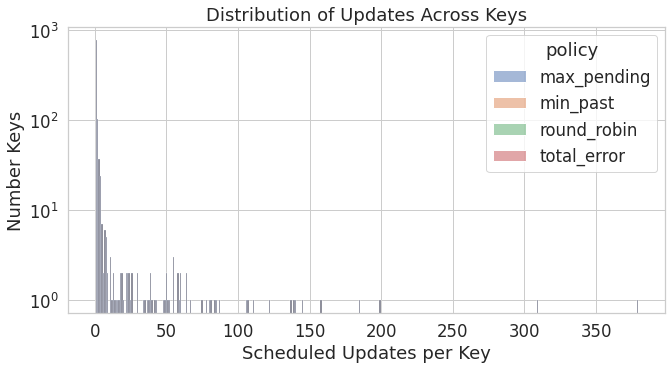

In [371]:
runtime = 1.0
sns.set(rc={'figure.figsize':(10.7,5.27)})
hist_df = updates_df[updates_df["runtime"] == runtime].groupby(by=["key", "policy"]).size()
hist_df = hist_df.to_frame(name="updates").reset_index()
#hist_df["policy"] = hist_df.policy.map({'total_error': 'Accuracy Optimized', 'round_robin': 'Baseline', 'avg_error': '(Avg) Accuracy Optimized'})

sns.set_theme(style="whitegrid", font_scale=1.5)
g = sns.histplot(data=hist_df, x="updates", hue="policy", log_scale=(False, True), discrete=True)
g.set(title="Distribution of Updates Across Keys", xlabel="Scheduled Updates per Key",  ylabel="Number Keys")

In [372]:
updates_df[updates_df["key"] == 1941]

,Unnamed: 0,policy,runtime,key,i,time


In [373]:
updates_df[(updates_df["policy"] == "total_error"]

,Unnamed: 0,policy,runtime,key,i,time
0,0,total_error,1.0,4226,0,0
1,1,total_error,1.0,4198,0,1
2,2,total_error,1.0,5689,0,2
3,3,total_error,1.0,4148,0,3
4,4,total_error,1.0,4130,0,4
...,...,...,...,...,...,...
11907,11907,total_error,0.5,5950,7,8113
11908,11908,total_error,0.5,5950,8,8114
11909,11909,total_error,0.5,5950,9,8114
11910,11910,total_error,0.5,5950,10,8115
